In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler

In [2]:
from sklearn.linear_model import Ridge,Lasso,RidgeCV,LassoCV,ElasticNetCV,LogisticRegression

In [3]:
df=pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [9]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [5]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model  import Ridge,Lasso,RidgeCV, LassoCV, ElasticNet, ElasticNetCV, LogisticRegression
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import seaborn as sns
import pickle


In [6]:
pf=ProfileReport(df)

In [7]:
pf

Summarize dataset:   0%|          | 0/22 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
df['BMI']=df['BMI'].replace(0,df['BMI'].mean())

In [11]:
df['Glucose']=df['Glucose'].replace(0,df['Glucose'].mean())

In [12]:
df['BloodPressure']=df['BloodPressure'].replace(0,df['BloodPressure'].mean())

In [13]:
df['Insulin']=df['Insulin'].replace(0,df['Insulin'].mean())

In [14]:
df['SkinThickness']=df['SkinThickness'].replace(0,df['SkinThickness'].mean())

In [15]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/22 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#removing outliers

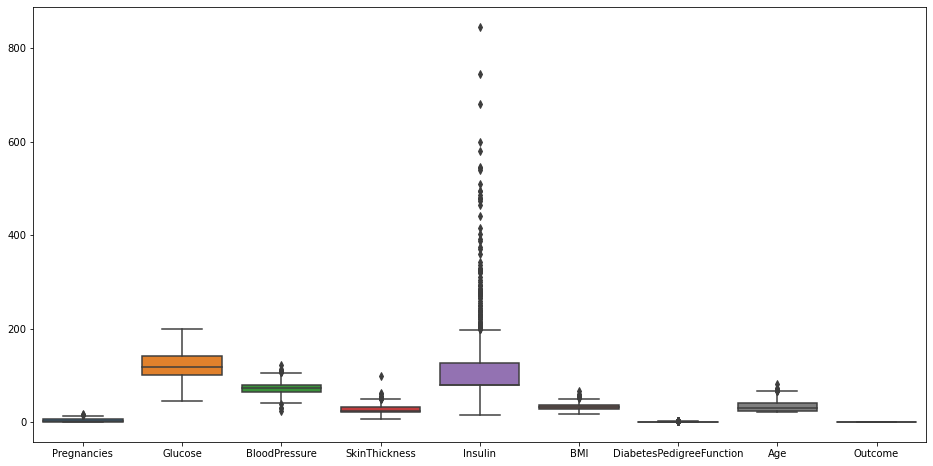

In [19]:
fig,ax=plt.subplots(figsize=(16,8))
sns.boxplot(data=df,ax=ax)

In [32]:
q=df['Insulin'].quantile(.70)
df_new=df[df['Insulin']<q]

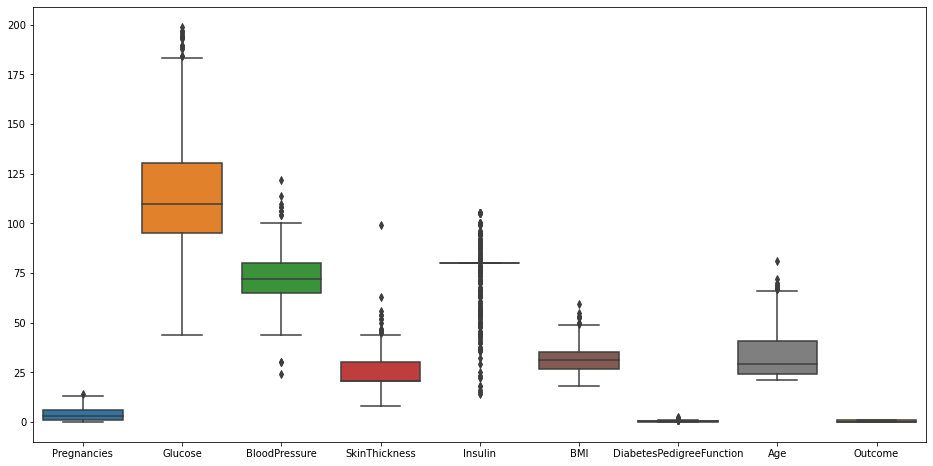

In [33]:
fig,ax=plt.subplots(figsize=(16,8))
sns.boxplot(data=df_new,ax=ax)

In [37]:
q=df['Pregnancies'].quantile(.95)
df_new=df[df['Pregnancies']<q]

q=df['BMI'].quantile(.99)
df_new=df_new[df_new['BMI']<q]

q=df['BMI'].quantile(.99)
df_new=df_new[df_new['BMI']<q]
q=df['BMI'].quantile(.99)
df_new=df_new[df_new['BMI']<q]


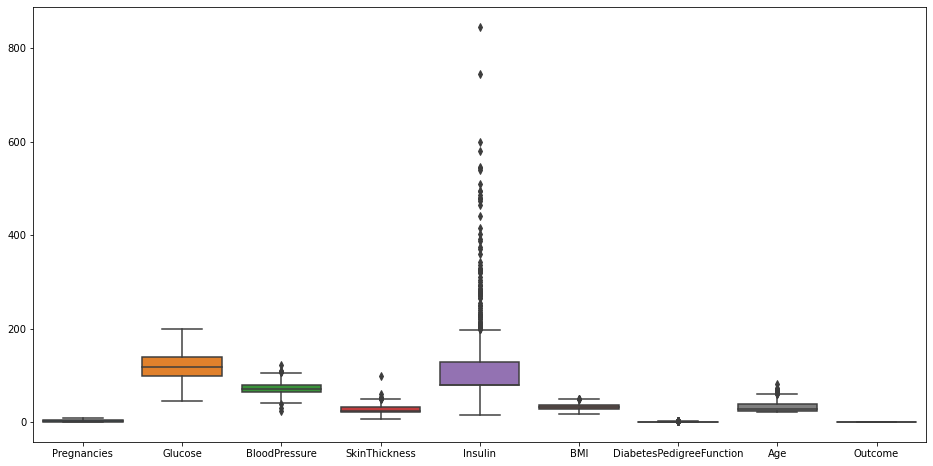

In [38]:
fig,ax=plt.subplots(figsize=(16,8))
sns.boxplot(data=df_new,ax=ax)

In [40]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [41]:
y=df_new['Outcome']
y

0      1
1      0
2      1
3      0
4      1
      ..
762    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 703, dtype: int64

In [42]:
x=df_new.drop(columns=['Outcome'])

In [43]:
x

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33
...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [45]:
scalar=StandardScaler()
ProfileReport(pd.DataFrame(scalar.fit_transform(df_new)))

Summarize dataset:   0%|          | 0/22 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df_nw_scalar=pd.DataFrame